| Name | MatrNr | Mail |
|------|----------|-----|
|Dorian He | ????| dorianhe@fu-berlin.de ???  |
|Rémi Toudic | 4318284 | remitoudic@gmail.com|

#  MusterErkennung :  Ub 8.1 

 ##  Import digits Dataset

In [1]:
import pandas as pd 
import numpy as np
df= pd.read_csv( 'zip.train' ,header= None, sep= '\s',engine='python' )

## Preprocessing

In [2]:
# a little preprocessing before... 
shapeDF=df.shape
dimension= shapeDF[1]-1

#split data table into data X and class labels y
X = df.ix[:,1:(dimension)].values
y = df.ix[:,0].values

print(X.shape, y.shape)

(7291, 256) (7291,)


##  PCA :  Covariance  matrix /    Eigenvalues  and eigenvectors  /  Projection on subspace 

In [3]:
def PCA (X,k): 
    # X = data as numpy array
    # k = dimension of the reduced features subspace 
    
    dimension = X.shape[1]
    
    # normalize with function mentioned in excercise class
    from sklearn.preprocessing import StandardScaler
    X_std = StandardScaler().fit_transform(X)
    
    #covariance matrix 
    covariancematrix=np.cov(X_std, rowvar=False) #rowvar: each column is a variable
    
    # eigenvalues / eigentvectors
    global eigenValues
    global eigenVectors
    eigenValues, eigenVectors = np.linalg.eig(covariancematrix)

    
    #sorted eigenvalue  with their respective eigenvectors from the bigest to the smallest
    # k is 2 cf. excercise
    idx = eigenValues.argsort()[-k:][::-1]
    eigenValues = eigenValues[idx]
    Main_component = eigenVectors[:,idx]

    list_MPC= [Main_component[:,comp].reshape(dimension,1)for comp in range(k)  ]
    
    matrix_w = np.hstack( list_MPC)
    #print(matrix_w.shape)
    #print(, matrix_w)

    #Projection
    global Y 
    Y=X_std.dot(matrix_w)
     
    return   Y 
print('Features reduced Space:')
print( PCA(X,2)) 


Features reduced Space:
[[  4.4708816   -8.39776877]
 [ 10.53787121  -0.74450079]
 [ -0.50936756  -0.33073997]
 ..., 
 [  3.89680276   1.4700305 ]
 [ 16.98743035  -2.85960046]
 [ -7.32303279  -3.11927668]]


##  Visualisation onto the New Feature Space ( 2 dimensional) 

###  1) All  digits  in one plot  (extra)

In [4]:
#  !!!!   Please if you use plotly for the first time uncomment the line below a comment it again after one run . 
#plotly.tools.set_credentials_file(username='remitoudic', api_key='aupwO29X8t2SyCOWs5y6')


from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.graph_objs import *
import plotly.offline as offline

# set up 
init_notebook_mode(connected=True)
traces = []

for name in (0,1,2,3,4,5,6,7,8,9):

    trace = Scatter(
        x=Y[y==name,0],
        y=Y[y==name,1],
        mode='markers',
        name=name,
        marker=Marker(
            size=12,
            line=Line(
                color='rgba(217, 217, 217, 0.14)',
                width=0.5),
            opacity=0.8))
    traces.append(trace)


data = Data(traces)
layout = Layout(showlegend=True,
                title='All digits ',
                xaxis=XAxis(title='PC1'),
                yaxis=YAxis(title='PC2'),)

fig = Figure(data=data, layout=layout)
offline.iplot(fig)

## Pairewise digits plots  

In [5]:
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.graph_objs import *
import plotly.offline as offline

def vizPCA(List_labels): 
    # set up 
    init_notebook_mode(connected=True)
    traces = []

    for name in (List_labels[0],List_labels[1]):

        trace = Scatter(
            x=Y[y==name,0],
            y=Y[y==name,1],
            mode='markers',
            name=name,
            marker=Marker(
                size=12,
                line=Line(
                    color='rgba(217, 217, 217, 0.14)',
                    width=0.5),
                opacity=0.8))
        traces.append(trace)


    data = Data(traces)
    layout = Layout(showlegend=True,
                    title=   'Plot Pairwise labels '+ str(List_labels),
                    xaxis=XAxis(title='PC1'),
                    yaxis=YAxis(title='PC2'),)

    fig = Figure(data=data, layout=layout)
    return offline.iplot(fig)



import itertools
a=(0,1,2,3,4,5,6,7,8,9)
pairwise= set((r[0] , r[1] ) for r in itertools.product(a, a) )
pairwise= list(pairwise)
pairwise.sort()


### Warning ! no subplot  so it is going to plot a lot  in the next cell ....

In [6]:
#for testing  with label  0 and 1,  please  uncomment the line below 
#vizPCA([0,6])

#If you want to see all the  2 labels plots as asked in the excercice.please  uncomment the 2 lines below .

for elements in pairwise:
    vizPCA(elements)

#  MusterErkennung  Ub 8.2  :   PCA and faces  ( in working process...) 

## Preprocessing the images

In [7]:
from PIL import Image
from os import listdir
import numpy as np 
image_folder=  './lfwcrop_grey/faces/'
images= listdir(image_folder)  
print('Number of images:',len(images) )

imagebox= list()
number_of_immage=1000

for img in range(number_of_immage):
    path= './lfwcrop_grey/faces/'+ images[img]
    IMG= Image.open(path)
    arr=np.array(IMG)
    arr=arr.reshape(4096,1)  #squeez the image in one row
    imagebox.append(arr)     # put every image in a box ! 

    
# every row of 'image box' is a image.  
imagebox=np.array(imagebox)
imagebox= np.concatenate((imagebox), axis=1)

imagebox.shape

Number of images: 13233


(4096, 1000)

## A ) How big should be  the features Space ? 

### For this question we choose the ' explained Variance' method . 

In [8]:
k= 1000

PCA(imagebox,k)


from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
from plotly.graph_objs import *
import plotly.offline as offline


components_viz=k

tot = sum(eigenValues)
var_exp = [(i / tot)*100 for i in sorted(eigenValues, reverse=True)]
cum_var_exp = np.cumsum(var_exp)


trace1 = Bar(
        x=['PC %s' %i for i in range(1,components_viz)],
        y=var_exp,
        showlegend=False)

trace2 = Scatter(
        x=['PC %s' %i for i in range(1,components_viz)], 
        y=cum_var_exp,
        name='cumulative explained variance')

data = Data([trace1, trace2])

layout=Layout(
        yaxis=YAxis(title='Explained variance in percent'),
        title='Explained variance by different principal components')

fig = Figure(data=data, layout=layout)

offline.iplot(fig)




/usr/local/lib/python3.5/dist-packages/sklearn/utils/validation.py:429: DataConversionWarning:

Data with input dtype uint8 was converted to float64 by StandardScaler.



### How we see  the number of components  we should choose depends of the energy and the accurency a of future calculation we aim to. 
    #### To get over  99% you neeed 410 components. 
    #### to get over 65%  you neeed 15 components.

## B ) Values of the Principal Component as Intensity of the gray image  

/usr/local/lib/python3.5/dist-packages/sklearn/utils/validation.py:429: DataConversionWarning:

Data with input dtype uint8 was converted to float64 by StandardScaler.



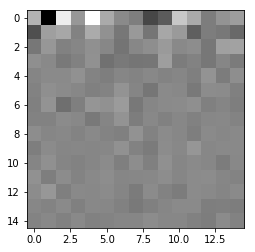

In [9]:
# we read the reduced image ,for the purpose we resize.
# we consider as intensity of the gray the value of the principal component. 

from matplotlib import pyplot as plt
%matplotlib inline


#set dimension of the image recovered. 
# let have square picture 
image_index= 60
number_of_PC= 225
image_dim=int(np.sqrt(number_of_PC))


reduced_images= PCA(imagebox,number_of_PC)


IMG= reduced_images[ image_index,:]
image_resized=IMG.reshape(image_dim,image_dim)
plt.imshow(image_resized, cmap='gray')



In [10]:
###  Something went wrong !!!! 